In [2]:
import sys
import anndata
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns 
import scipy
import matplotlib.pyplot as plt
sys.path.insert(-1, '../..')
import _utils

In [3]:
full_fn = anndata.read('../thymus_annotation/annotation/query_and_reference_final.h5ad')

In [4]:
full_fn[full_fn.obs['_dataset']=='query']

View of AnnData object with n_obs × n_vars = 255901 × 4000
    obs: 'tissue_in_publication', 'donor_id', 'free_annotation', 'compartment', 'cell_type_ontology_term_id', 'cell_type', 'assay', 'sex', 'tissue', 'cell_ontology_class', 'cell_ontology_class_tissue', 'donor_tissue', 'assay_correct', 'donor_assay', 'cell_ontology_class_original', '_batch_annotation', '_labels_annotation', '_ref_subsample', 'Sample', 'paper_annotation', 'development_stage', '_dataset', 'n_counts', 'popv_celltypist_prediction', 'popv_celltypist_prediction_probabilities', 'popv_knn_on_bbknn_prediction', 'popv_knn_on_bbknn_prediction_probabilities', 'popv_knn_on_scanorama_prediction', 'popv_knn_on_scanorama_prediction_probabilities', 'subsampled_labels', '_scvi_batch', '_scvi_labels', 'popv_knn_on_scvi_prediction', 'popv_knn_on_scvi_prediction_probabilities', '_labels_annotation_cell_ontology_id', 'popv_onclass_prediction', 'popv_onclass_seen', 'popv_onclass_prediction_probabilities', 'popv_onclass_seen_probabilit

In [5]:
ref = full_fn[full_fn.obs['_dataset']=='ref'].copy()

/home/cane/miniconda3/envs/popv_bench/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/popv_bench/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/popv_bench/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/popv_bench/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/popv_bench/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data f

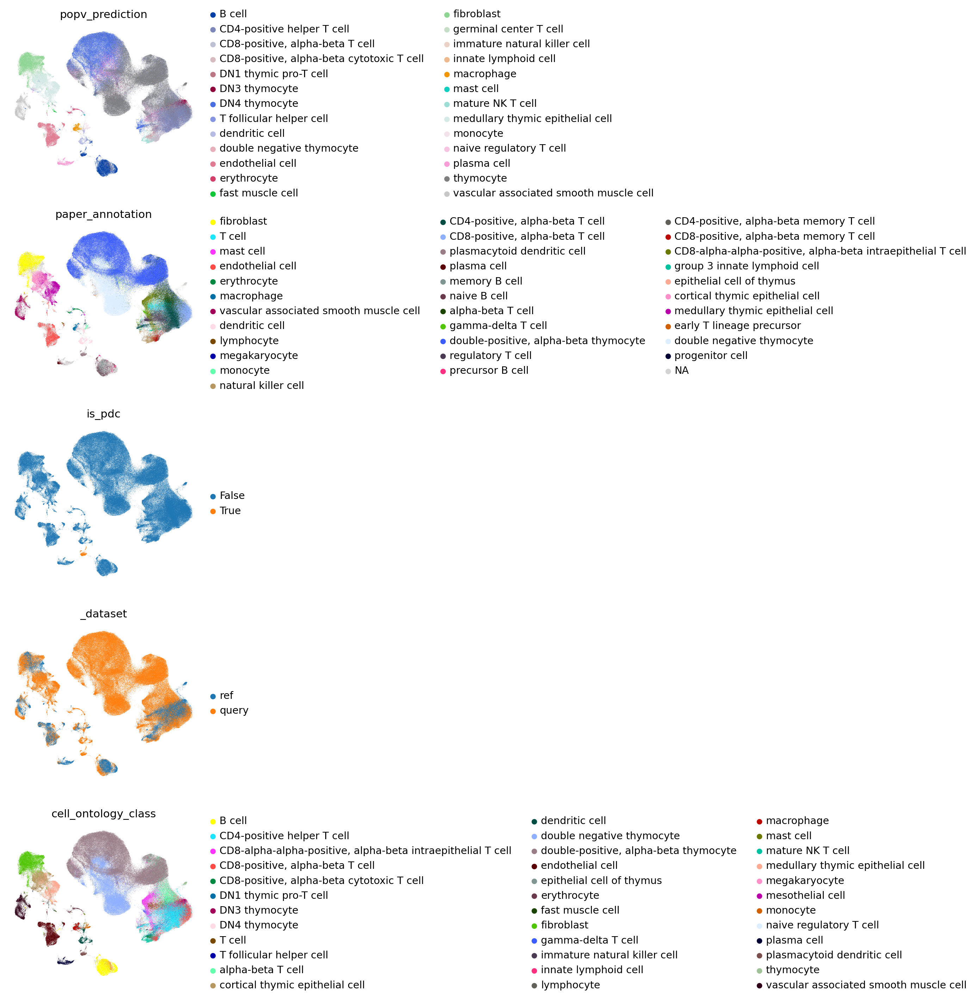

In [6]:
full_fn.obsm['X_umap'] = full_fn.obsm['X_scanvi_umap_popv']
full_fn.obs['is_pdc'] = [str(i=='plasmacytoid dendritic cell') for i in full_fn.obs['paper_annotation']]
sc.pl.umap(full_fn, color=['popv_prediction', 'paper_annotation', 'is_pdc', '_dataset', 'cell_ontology_class'], ncols=1)

/home/cane/miniconda3/envs/popv_bench/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


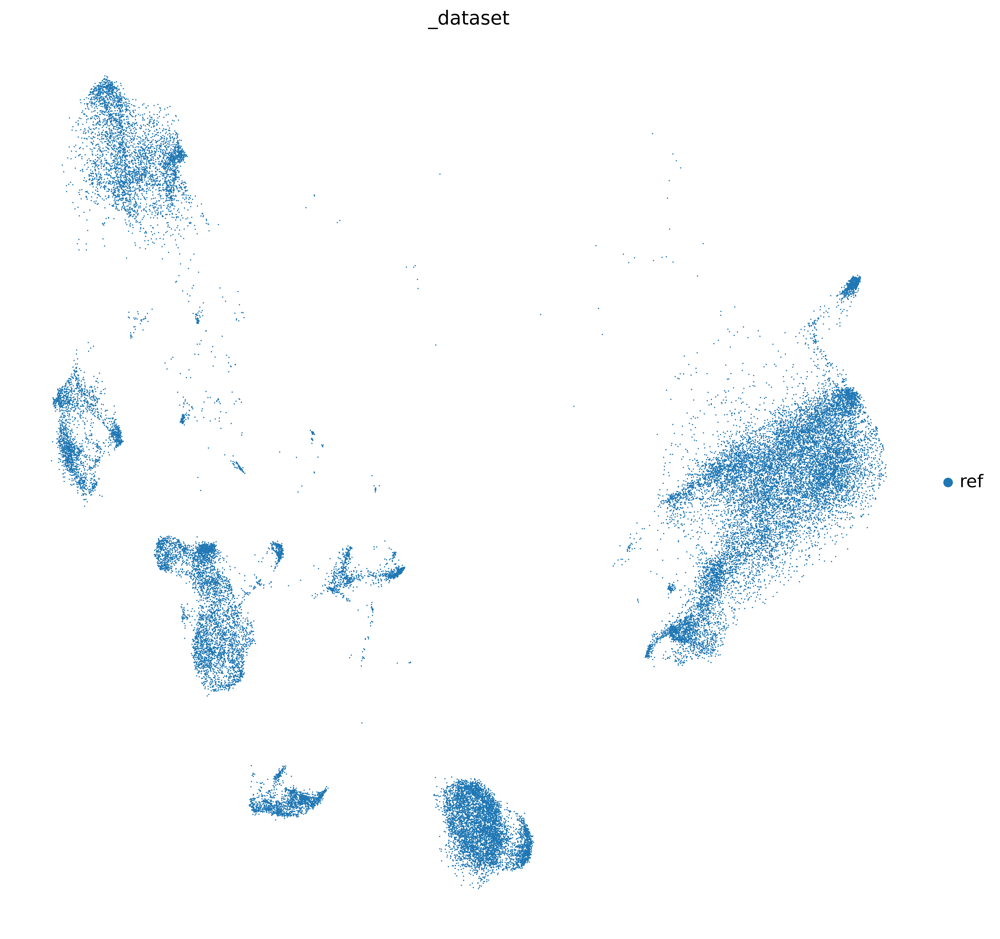

In [7]:
with plt.rc_context({"figure.figsize": (12, 12), "figure.dpi": (300)}):
    sc.pl.umap(full_fn[full_fn.obs['_dataset']=='ref'], color=['_dataset'], ncols=1)

/home/cane/miniconda3/envs/popv_bench/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/popv_bench/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/popv_bench/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/popv_bench/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/popv_bench/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data f

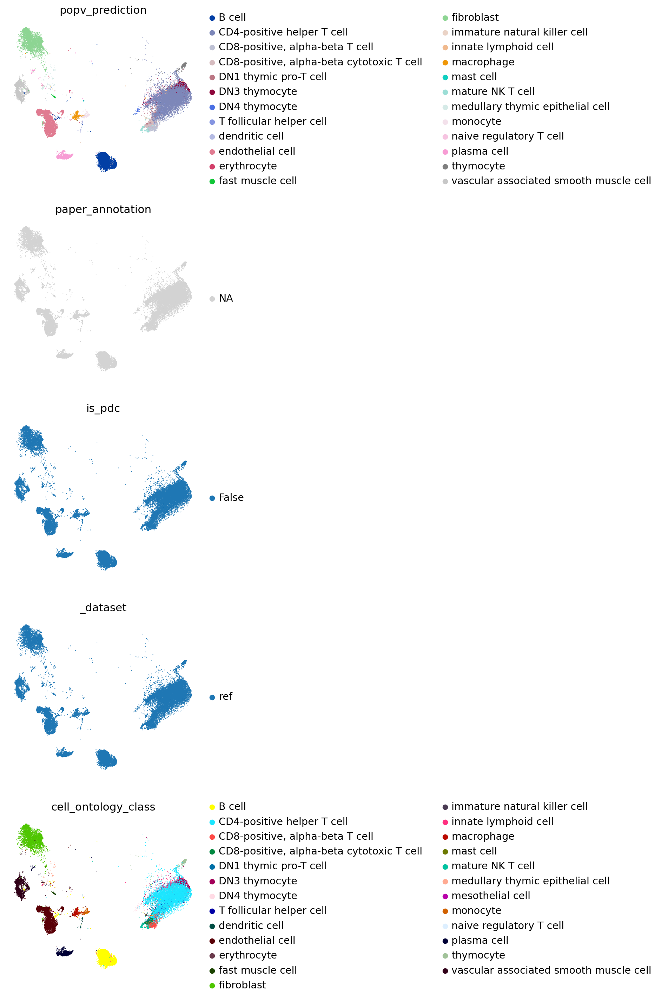

In [8]:
sc.pl.umap(full_fn[full_fn.obs['_dataset']=='ref'], color=['popv_prediction', 'paper_annotation', 'is_pdc', '_dataset', 'cell_ontology_class'], ncols=1)

In [9]:
query = full_fn[full_fn.obs['_dataset']=='query'].copy()
query.obsm['X_umap'] = query.obsm['X_scanvi_umap_popv']

# Probability vs agreement

In [14]:
color_map = ['#1f77b4',
             '#2ca02c',
             '#9467bd',
             '#ff7f0e',
             '#d62728',
             '#8c564b',
             '#e377c2',
             '#7f7f7f',
             '#bcbd22',
             '#17becf']

In [15]:
parent = 'parent'
child = 'child'
exact = 'exact'
sibling = 'sibling'

In [16]:
query.obs['popv_prediction_probabilities'] = query.obs['popv_prediction_score'].astype(float)/query.obs['popv_prediction_score'].astype(float).max()

In [17]:
acc_annotated_cols_dict = {
 'popv_celltypist_prediction_ontology_accuracy': 'popv_celltypist_prediction',
 'popv_knn_on_bbknn_prediction_ontology_accuracy': 'popv_knn_on_bbknn_prediction',
 'popv_knn_on_scanorama_prediction_ontology_accuracy': 'popv_knn_on_scanorama_prediction',
 'popv_knn_on_scvi_prediction_ontology_accuracy': 'popv_knn_on_scvi_prediction',
 'popv_onclass_prediction_ontology_accuracy': 'popv_onclass_prediction',
 'popv_onclass_seen_ontology_accuracy': 'popv_onclass_seen',
 'popv_rf_prediction_ontology_accuracy': 'popv_rf_prediction',
 'popv_scanvi_prediction_ontology_accuracy': 'popv_scanvi_prediction',
 'popv_svm_prediction_ontology_accuracy': 'popv_svm_prediction',
 'seurat_prediction_ontology_accuracy': 'seurat_prediction',
 'consensus_ontology_accuracy': 'popv_prediction'}

In [18]:
query.obs['seurat_prediction_probabilities'] = query.obs['seurat_probability']

In [19]:
parent = 'parent'
child = 'child'
exact = 'exact'
sibling = 'sibling'

In [20]:
acc_annotated_cols_dict = {
    'consensus_ontology_accuracy': 'popv_prediction',
    'popv_celltypist_prediction_ontology_accuracy': 'popv_celltypist_prediction',
    'popv_knn_on_bbknn_prediction_ontology_accuracy': 'popv_knn_on_bbknn_prediction',
    'popv_knn_on_scanorama_prediction_ontology_accuracy': 'popv_knn_on_scanorama_prediction',
    'popv_knn_on_scvi_prediction_ontology_accuracy': 'popv_knn_on_scvi_prediction',
    'popv_onclass_seen_ontology_accuracy': 'popv_onclass_seen',
    'popv_rf_prediction_ontology_accuracy': 'popv_rf_prediction',
    'popv_svm_prediction_ontology_accuracy': 'popv_svm_prediction',
    'seurat_prediction_ontology_accuracy': 'seurat_prediction',
    'popv_scanvi_prediction_ontology_accuracy': 'popv_scanvi_prediction',
    'popv_onclass_prediction_ontology_accuracy': 'popv_onclass_prediction',
}



In [21]:
rename_dict = {
    'popv_prediction': 'popV',
    'popv_celltypist_prediction': 'Celltypist',
    'popv_knn_on_bbknn_prediction': 'KNN on BBKNN',
    'popv_knn_on_scanorama_prediction': 'KNN on Scanorama',
    'popv_knn_on_scvi_prediction': 'KNN on scVI',
    'popv_onclass_seen': 'OnClass (seen)',
    'popv_rf_prediction': 'Random Forest',
    'popv_svm_prediction': 'SVM',
    'seurat_prediction': 'Seurat',
    'popv_scanvi_prediction': 'scANVI',
    'popv_onclass_prediction': 'OnClass',
}

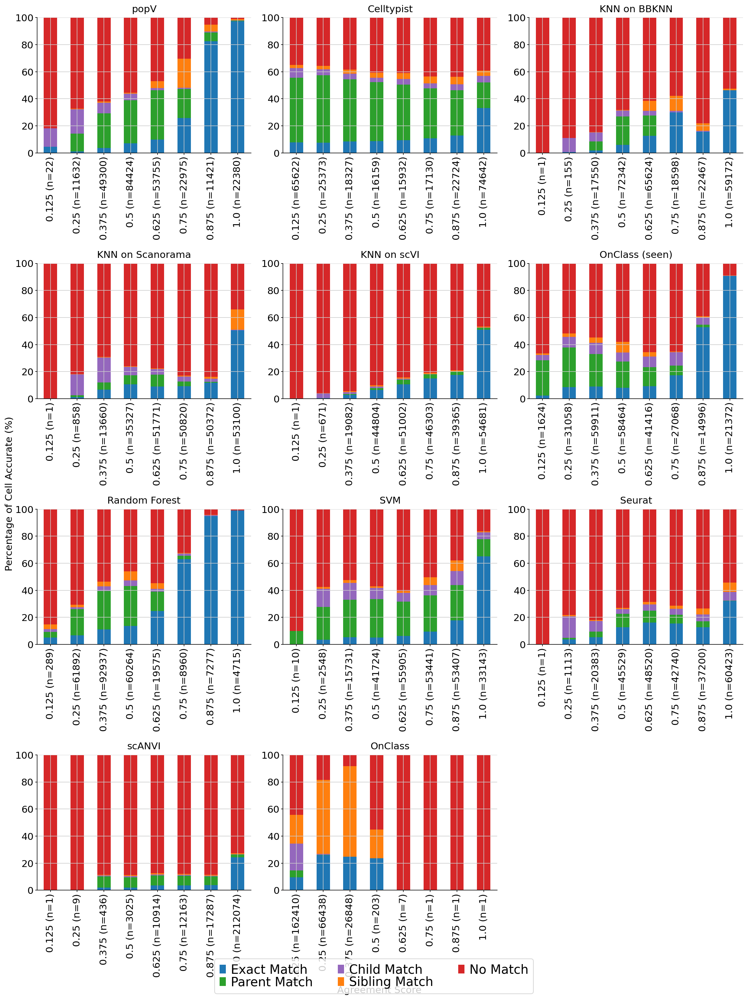

In [22]:
scores = [1, 2, 3, 4, 5, 6, 7, 8]
fig, axs = plt.subplots(4, 3, figsize=(15, 20))
idx = -1
for ontology_accuracy, prediction_key in acc_annotated_cols_dict.items():
    idx += 1
    exact_acc = []
    parent_acc = []
    child_acc = []
    sibling_acc = []
    neighborhood_acc = []
    ns = []
    for score in scores:
        df = query.obs[[prediction_key+'_probabilities', ontology_accuracy]]
        tmp = df[np.logical_and(df[prediction_key+'_probabilities']>(score-1)/np.max(scores), df[prediction_key+'_probabilities']<=score/np.max(scores))]
        n = tmp.shape[0] + 1
        
        ns.append(n)
        
        correct1 = tmp[tmp[ontology_accuracy] == exact].shape[0]
        exact_acc.append(correct1/n)
        
        correct2 = tmp[tmp[ontology_accuracy] == parent].shape[0]
        parent_acc.append(correct2/n)
        
        correct3 = tmp[tmp[ontology_accuracy] == child].shape[0]
        child_acc.append(correct3/n)
        
        correct4 = tmp[tmp[ontology_accuracy] == sibling].shape[0]
        sibling_acc.append(correct4/n)
        
        neighborhood_score = (correct1+correct2+correct3+correct4)/n
        neighborhood_acc.append(neighborhood_score)
    
    labels = [f'{s} (n={n})' for s,n in zip(scores/np.max(scores), ns)]
    df = pd.DataFrame(index = labels)
    df['Exact Match'] = exact_acc * np.array(ns) #/ np.sum(ns)
    df['Parent Match'] = parent_acc * np.array(ns) #/ np.sum(ns)
    df['Child Match'] = child_acc * np.array(ns) #/ np.sum(ns)
    df['Sibling Match'] = sibling_acc * np.array(ns) #/ np.sum(ns)
    df['No Match'] =  (np.array(ns) - df.sum(axis=1)) #/ np.sum(ns)
    df = 100 * df.div(df.sum(axis=1), axis=0)
    axs_ = axs[idx//3, idx%3]
    df.plot.bar(stacked=True, color=color_map, ax=axs_, legend=False)
    if df.values.sum(axis=1).max()>40:
        axs_.set_ylim(0, 100)
    else:
        axs_.set_ylim(0, 40)
    
    axs_.set_title(rename_dict[prediction_key])

    #axs_.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3),ncol=3)
    #plt.savefig(f'fig4/fig4_thymus_prediction_accuracy_{prediction_key}.pdf', bbox_inches='tight')
axs[-1, -1].axis('off')

handles, labels = axs_.get_legend_handles_labels()
fig.legend(handles, labels, loc='lower center', ncol=3, labelspacing=0., prop={'size': 18})

fig.text(0.5, 0, 'Agreement Score', ha='center')
fig.text(0, 0.5, 'Percentage of Cell Accurate (%)', va='center', rotation='vertical')
fig.tight_layout()
plt.savefig('fig4/fig4_thymus_score_accuracy.pdf', bbox_inches='tight')
plt.show()


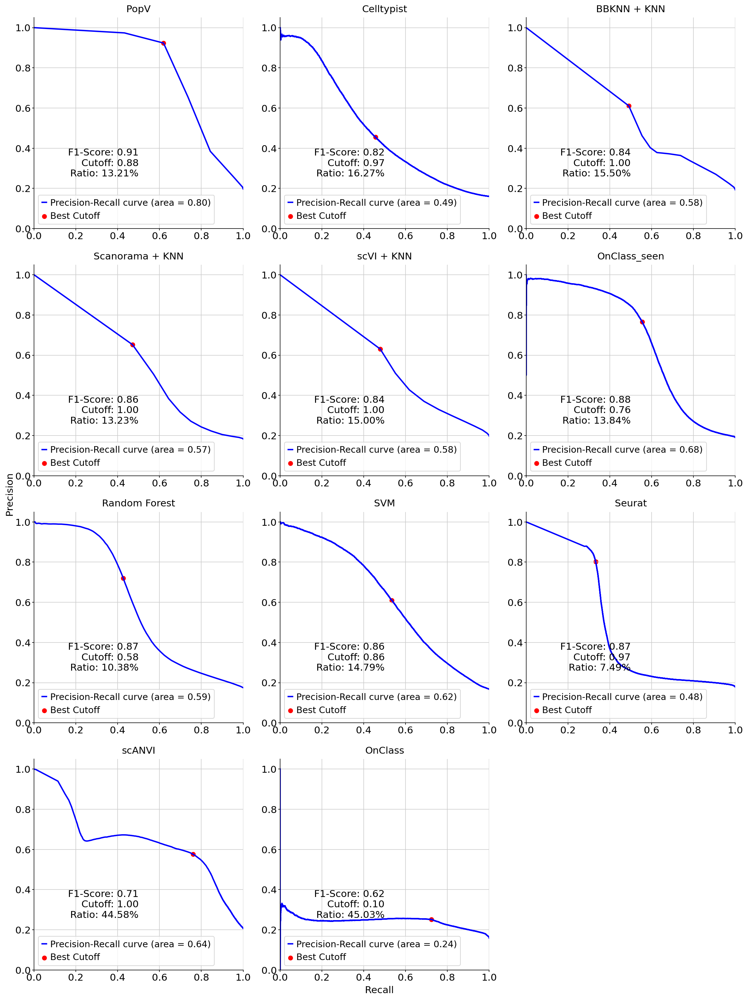

In [183]:
from sklearn.metrics import precision_recall_curve, auc, accuracy_score

scores = [1, 2, 3, 4, 5, 6, 7, 8]
fig, axs = plt.subplots(4, 3, figsize=(15, 20))
idx = -1
for ontology_accuracy, prediction_key in acc_annotated_cols_dict.items():
    idx += 1
    
    y_val = query.obs[ontology_accuracy]=='exact'
    probabilities = query.obs[prediction_key+'_probabilities']

    # Compute Precision-Recall curve and area under the curve
    precision, recall, thresholds = precision_recall_curve(y_val, probabilities)
    pr_auc = auc(recall, precision)

    # Calculate the F1 score to find the best threshold (cutoff)
    f1_scores = 2*recall*precision / (recall + precision + 1e-3)
    best_idx = np.argmax(f1_scores)
    best_cutoff = thresholds[best_idx]

    # Apply the best cutoff to make final predictions
    predictions = np.where(probabilities > (best_cutoff - 1e-3), 1, 0)

    # Calculate the accuracy of predictions above the cutoff
    accuracy_above_cutoff = accuracy_score(y_val, predictions)
    axs_ = axs[idx//3, idx%3]
    
    axs_.plot(recall, precision, color='blue', lw=2, label='Precision-Recall curve (area = %0.2f)' % pr_auc)
    axs_.scatter(recall[best_idx], precision[best_idx], marker='o', color='red', label='Best Cutoff')
    axs_.annotate(f'F1-Score: {accuracy_above_cutoff:.2f}\nCutoff: {best_cutoff:.2f}\nRatio: {(np.mean(predictions) * 100):.2f}%',
                xy=(recall[best_idx], precision[best_idx]), xytext=(0.5, 0.4),
                horizontalalignment='right', verticalalignment='top')
    axs_.legend(loc="lower left")
    axs_.set_title(rename_dict[prediction_key])
    axs_.set_xlim([0.0, 1.0])
    axs_.set_ylim([0.0, 1.05])

    #axs_.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3),ncol=3)
    #plt.savefig(f'fig4/fig4_thymus_prediction_accuracy_{prediction_key}.pdf', bbox_inches='tight')
axs[-1, -1].axis('off')
fig.text(0.5, 0, 'Recall', ha='center')
fig.text(0, 0.5, 'Precision', va='center', rotation='vertical')
fig.tight_layout()
plt.savefig('fig4/fig4_thymus_precision_recall.pdf', bbox_inches='tight')
plt.show()


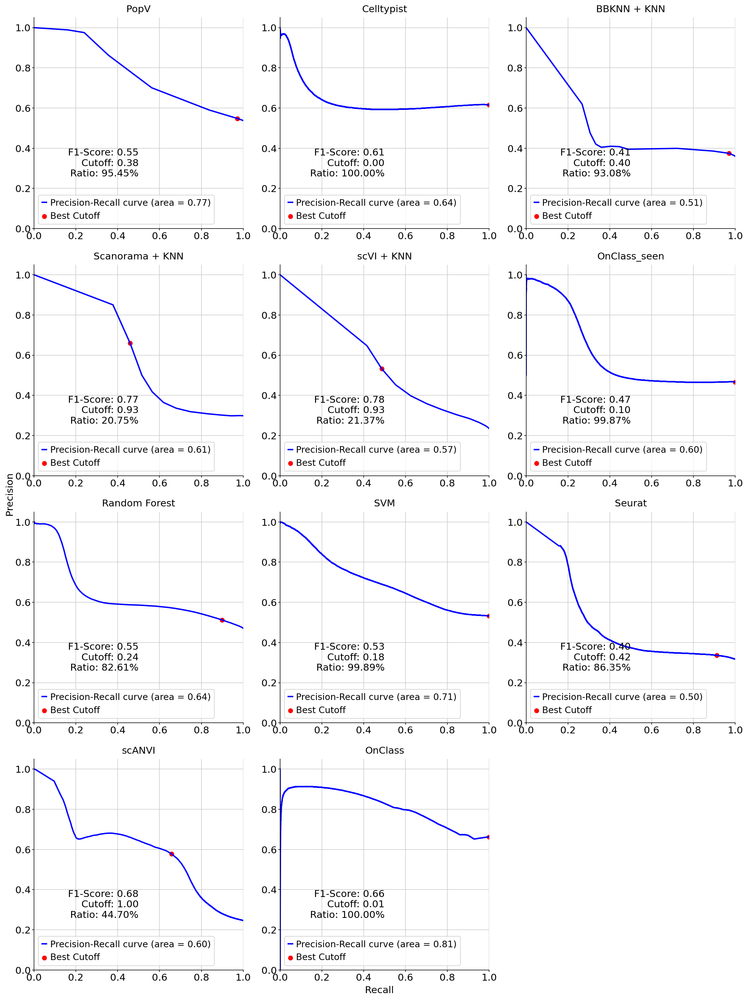

In [282]:
from sklearn.metrics import precision_recall_curve, auc, accuracy_score

scores = [1, 2, 3, 4, 5, 6, 7, 8]
fig, axs = plt.subplots(4, 3, figsize=(15, 20))
idx = -1
for ontology_accuracy, prediction_key in acc_annotated_cols_dict.items():
    idx += 1
    
    y_val = query.obs[ontology_accuracy]!='no match'
    probabilities = query.obs[prediction_key+'_probabilities']

    # Compute Precision-Recall curve and area under the curve
    precision, recall, thresholds = precision_recall_curve(y_val, probabilities)
    pr_auc = auc(recall, precision)

    # Calculate the F1 score to find the best threshold (cutoff)
    f1_scores = 2*recall*precision / (recall + precision + 1e-3)
    best_idx = np.argmax(f1_scores)
    best_cutoff = thresholds[best_idx]

    # Apply the best cutoff to make final predictions
    predictions = np.where(probabilities > (best_cutoff - 1e-3), 1, 0)

    # Calculate the accuracy of predictions above the cutoff
    accuracy_above_cutoff = accuracy_score(y_val, predictions)
    axs_ = axs[idx//3, idx%3]
    
    axs_.plot(recall, precision, color='blue', lw=2, label='Precision-Recall curve (area = %0.2f)' % pr_auc)
    axs_.scatter(recall[best_idx], precision[best_idx], marker='o', color='red', label='Best Cutoff')
    axs_.annotate(f'F1-Score: {accuracy_above_cutoff:.2f}\nCutoff: {best_cutoff:.2f}\nRatio: {(np.mean(predictions) * 100):.2f}%',
                xy=(recall[best_idx], precision[best_idx]), xytext=(0.5, 0.4),
                horizontalalignment='right', verticalalignment='top')
    axs_.legend(loc="lower left")
    axs_.set_title(rename_dict[prediction_key])
    axs_.set_xlim([0.0, 1.0])
    axs_.set_ylim([0.0, 1.05])

    #axs_.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3),ncol=3)
    #plt.savefig(f'fig4/fig4_thymus_prediction_accuracy_{prediction_key}.pdf', bbox_inches='tight')
axs[-1, -1].axis('off')
fig.text(0.5, 0, 'Recall', ha='center')
fig.text(0, 0.5, 'Precision', va='center', rotation='vertical')
fig.tight_layout()
#plt.savefig('fig4/fig4_thymus_precision_recall_all.pdf', bbox_inches='tight')
plt.show()


In [115]:
acc_annotated_cols = [s for s in query.obs.keys() if s.endswith('_ontology_accuracy')]
adult = query[query.obs['development_stage']=='human early adulthood stage']

In [116]:
df = adult.obs[acc_annotated_cols].apply(pd.Series.value_counts).T.sort_values('exact', ascending=False)
df.div(df.sum(axis=1), axis=0)

,child,exact,no match,parent,sibling
consensus_ontology_accuracy,0.023636,0.877127,0.079328,0.017848,0.002061
popv_knn_on_scanorama_prediction_ontology_accuracy,0.014383,0.869190,0.106780,0.007586,0.002061
popv_knn_on_bbknn_prediction_ontology_accuracy,0.016751,0.862217,0.107174,0.011796,0.002061
popv_svm_prediction_ontology_accuracy,0.032582,0.853315,0.093273,0.018725,0.002105
popv_knn_on_scvi_prediction_ontology_accuracy,0.010700,0.853184,0.134713,0.000789,0.000614
popv_celltypist_prediction_ontology_accuracy,0.047316,0.850772,0.080030,0.019777,0.002105
popv_rf_prediction_ontology_accuracy,0.033722,0.850289,0.097044,0.017322,0.001623
popv_onclass_seen_ontology_accuracy,0.019163,0.843931,0.119628,0.015173,0.002105
popv_scanvi_prediction_ontology_accuracy,0.006885,0.756271,0.233775,0.001842,0.001228
seurat_prediction_ontology_accuracy,0.011796,0.650237,0.326171,0.009823,0.001973


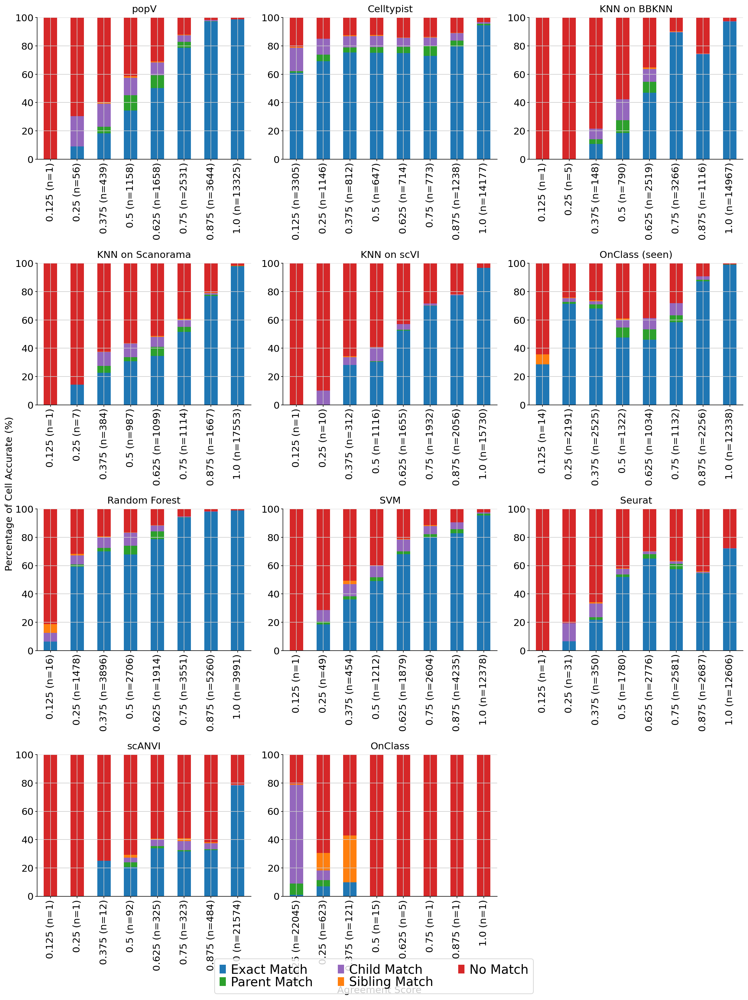

In [25]:
scores = [1, 2, 3, 4, 5, 6, 7, 8]
fig, axs = plt.subplots(4, 3, figsize=(15, 20))
idx = -1
for ontology_accuracy, prediction_key in acc_annotated_cols_dict.items():
    idx += 1
    exact_acc = []
    parent_acc = []
    child_acc = []
    sibling_acc = []
    neighborhood_acc = []
    ns = []
    for score in scores:
        df = adult.obs[[prediction_key+'_probabilities', ontology_accuracy]]
        tmp = df[np.logical_and(df[prediction_key+'_probabilities']>(score-1)/np.max(scores), df[prediction_key+'_probabilities']<=score/np.max(scores))]
        n = tmp.shape[0] + 1
        
        ns.append(n)
        
        correct1 = tmp[tmp[ontology_accuracy] == exact].shape[0]
        exact_acc.append(correct1/n)
        
        correct2 = tmp[tmp[ontology_accuracy] == parent].shape[0]
        parent_acc.append(correct2/n)
        
        correct3 = tmp[tmp[ontology_accuracy] == child].shape[0]
        child_acc.append(correct3/n)
        
        correct4 = tmp[tmp[ontology_accuracy] == sibling].shape[0]
        sibling_acc.append(correct4/n)
        
        neighborhood_score = (correct1+correct2+correct3+correct4)/n
        neighborhood_acc.append(neighborhood_score)
    
    labels = [f'{s} (n={n})' for s,n in zip(scores/np.max(scores), ns)]
    df = pd.DataFrame(index = labels)
    df['Exact Match'] = exact_acc * np.array(ns) #/ np.sum(ns)
    df['Parent Match'] = parent_acc * np.array(ns) #/ np.sum(ns)
    df['Child Match'] = child_acc * np.array(ns) #/ np.sum(ns)
    df['Sibling Match'] = sibling_acc * np.array(ns) #/ np.sum(ns)
    df['No Match'] =  (np.array(ns) - df.sum(axis=1)) #/ np.sum(ns)
    df = 100 * df.div(df.sum(axis=1), axis=0)
    axs_ = axs[idx//3, idx%3]
    df.plot.bar(stacked=True, color=color_map, ax=axs_, legend=False)
    if df.values.sum(axis=1).max()>40:
        axs_.set_ylim(0, 100)
    else:
        axs_.set_ylim(0, 40)
    
    axs_.set_title(rename_dict[prediction_key])

    #axs_.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3),ncol=3)
    #plt.savefig(f'fig4/fig4_thymus_prediction_accuracy_{prediction_key}.pdf', bbox_inches='tight')
axs[-1, -1].axis('off')

handles, labels = axs_.get_legend_handles_labels()
fig.legend(handles, labels, loc='lower center', ncol=3, labelspacing=0., prop={'size': 18})

fig.text(0.5, 0, 'Agreement Score', ha='center')
fig.text(0, 0.5, 'Percentage of Cell Accurate (%)', va='center', rotation='vertical')
fig.tight_layout()
plt.savefig('fig4/fig4_thymus_score_adult_accuracy.pdf', bbox_inches='tight')
plt.show()


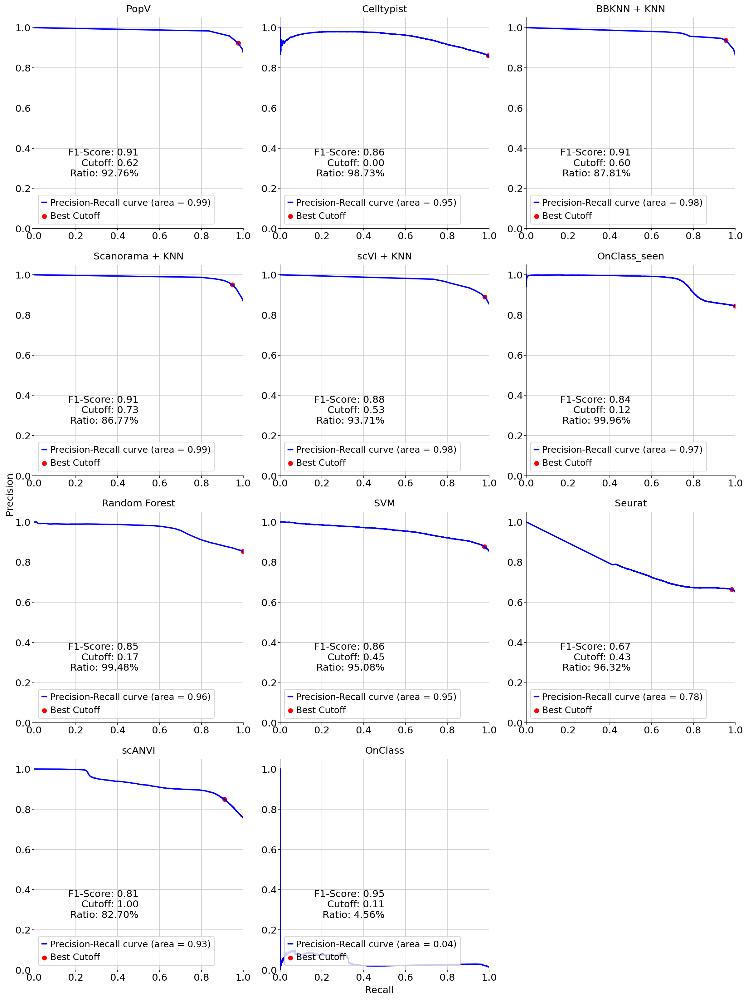

In [185]:
from sklearn.metrics import precision_recall_curve, auc, accuracy_score

scores = [1, 2, 3, 4, 5, 6, 7, 8]
fig, axs = plt.subplots(4, 3, figsize=(15, 20))
idx = -1
for ontology_accuracy, prediction_key in acc_annotated_cols_dict.items():
    idx += 1
    
    y_val = adult.obs[ontology_accuracy]=='exact'
    probabilities = adult.obs[prediction_key+'_probabilities']

    # Compute Precision-Recall curve and area under the curve
    precision, recall, thresholds = precision_recall_curve(y_val, probabilities)
    pr_auc = auc(recall, precision)

    # Calculate the F1 score to find the best threshold (cutoff)
    f1_scores = 2*recall*precision / (recall + precision + 1e-3)
    best_idx = np.argmax(f1_scores)
    best_cutoff = thresholds[best_idx]

    # Apply the best cutoff to make final predictions
    predictions = np.where(probabilities > (best_cutoff - 1e-3), 1, 0)

    # Calculate the accuracy of predictions above the cutoff
    accuracy_above_cutoff = accuracy_score(y_val, predictions)
    axs_ = axs[idx//3, idx%3]
    
    axs_.plot(recall, precision, color='blue', lw=2, label='Precision-Recall curve (area = %0.2f)' % pr_auc)
    axs_.scatter(recall[best_idx], precision[best_idx], marker='o', color='red', label='Best Cutoff')
    axs_.annotate(f'F1-Score: {accuracy_above_cutoff:.2f}\nCutoff: {best_cutoff:.2f}\nRatio: {(np.mean(predictions) * 100):.2f}%',
                xy=(recall[best_idx], precision[best_idx]), xytext=(0.5, 0.4),
                horizontalalignment='right', verticalalignment='top')
    axs_.legend(loc="lower left")
    axs_.set_title(rename_dict[prediction_key])
    axs_.set_xlim([0.0, 1.0])
    axs_.set_ylim([0.0, 1.05])

    #axs_.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3),ncol=3)
    #plt.savefig(f'fig4/fig4_thymus_prediction_accuracy_{prediction_key}.pdf', bbox_inches='tight')
axs[-1, -1].axis('off')
fig.text(0.5, 0, 'Recall', ha='center')
fig.text(0, 0.5, 'Precision', va='center', rotation='vertical')
fig.tight_layout()
plt.savefig('fig4/fig4_thymus_precision_recall_adult.pdf', bbox_inches='tight')
plt.show()


In [15]:
from popv import _utils

2024-02-13 11:20:54.723737: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-02-13 11:20:54.752560: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-02-13 11:20:55.378252: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
From /home/cane/miniconda3/envs/popv_bench/lib/python3.9/site-packages/tensorflow/python/compat/v2_compat.py:107: disable_resource_variables (from tensorflow.python.ops.variable_scope) is deprecated and will be removed in a future version.
Instructions for upda

In [10]:
import itertools
from sklearn.metrics import average_precision_score, f1_score
from sklearn.preprocessing import label_binarize

In [78]:
query_adata = query
output_folder = 'fig4'

In [79]:
prediction_keys = ['popv_celltypist_prediction', 'popv_knn_on_bbknn_prediction', 'popv_knn_on_scanorama_prediction',
                   'popv_knn_on_scvi_prediction', 'popv_rf_prediction', 'popv_svm_prediction', 'popv_scanvi_prediction'
                   ] # onclass
sub_prediction_list = list(itertools.combinations(prediction_keys, 5))

In [85]:
sub_prediction_list

[('popv_celltypist_prediction',
  'popv_knn_on_bbknn_prediction',
  'popv_knn_on_scanorama_prediction',
  'popv_knn_on_scvi_prediction',
  'popv_rf_prediction'),
 ('popv_celltypist_prediction',
  'popv_knn_on_bbknn_prediction',
  'popv_knn_on_scanorama_prediction',
  'popv_knn_on_scvi_prediction',
  'popv_svm_prediction'),
 ('popv_celltypist_prediction',
  'popv_knn_on_bbknn_prediction',
  'popv_knn_on_scanorama_prediction',
  'popv_knn_on_scvi_prediction',
  'popv_scanvi_prediction'),
 ('popv_celltypist_prediction',
  'popv_knn_on_bbknn_prediction',
  'popv_knn_on_scanorama_prediction',
  'popv_rf_prediction',
  'popv_svm_prediction'),
 ('popv_celltypist_prediction',
  'popv_knn_on_bbknn_prediction',
  'popv_knn_on_scanorama_prediction',
  'popv_rf_prediction',
  'popv_scanvi_prediction'),
 ('popv_celltypist_prediction',
  'popv_knn_on_bbknn_prediction',
  'popv_knn_on_scanorama_prediction',
  'popv_svm_prediction',
  'popv_scanvi_prediction'),
 ('popv_celltypist_prediction',
  'popv_

In [86]:
accuracy_results = {}
precision_results = {}

for sub_prediction_key in sub_prediction_list:
    # Generate sub-predictions by applying majority_vote to each combination
    sub_prediction = query_adata.obs[list(sub_prediction_key)].apply(_utils.majority_vote, axis=1)
    sub_prediction_score = query_adata.obs[list(sub_prediction_key)].apply(_utils.majority_count, axis=1)
    
    # Calculate accuracy
    # Binarize sub_predictions
    precision = average_precision_score(query_adata.obs['cell_ontology_class'].astype(str)==sub_prediction, sub_prediction_score, average='weighted')
    accuracy = f1_score(query_adata.obs['cell_ontology_class'], sub_prediction, average='weighted')
    
    entry = tuple([i for i in prediction_keys if i not in sub_prediction_key])
    
    # Store the accuracy
    precision_results[entry] = precision
    accuracy_results[entry] = accuracy

# Convert accuracy results to a format suitable for heatmap plotting
accuracy_df = pd.DataFrame(list(accuracy_results.items()), columns=['Combination', 'Accuracy'])
accuracy_df[['Key1', 'Key2']] = pd.DataFrame(accuracy_df['Combination'].tolist(), index=accuracy_df.index)
accuracy_df = accuracy_df.pivot("Key1", "Key2", "Accuracy")

# Convert accuracy results to a format suitable for heatmap plotting
precision_df = pd.DataFrame(list(precision_results.items()), columns=['Combination', 'Accuracy'])
precision_df[['Key1', 'Key2']] = pd.DataFrame(precision_df['Combination'].tolist(), index=precision_df.index)
precision_df = precision_df.pivot("Key1", "Key2", "Accuracy")

maxp pruned
cmap pruned
kern dropped
post pruned
FFTM dropped
GPOS pruned
GSUB pruned
glyf pruned
Added gid0 to subset
Added first four glyphs to subset
Closing glyph list over 'GSUB': 43 glyphs before
Glyph names: ['.notdef', '.null', 'A', 'F', 'O', 'P', 'S', 'a', 'b', 'c', 'colon', 'd', 'e', 'f', 'five', 'g', 'h', 'hyphen', 'i', 'k', 'l', 'm', 'minus', 'n', 'nonmarkingreturn', 'o', 'one', 'p', 'parenleft', 'parenright', 'period', 'r', 's', 'seven', 'space', 't', 'three', 'two', 'u', 'underscore', 'v', 'y', 'zero']
Glyph IDs:   [0, 1, 2, 3, 11, 12, 16, 17, 19, 20, 21, 22, 24, 26, 29, 36, 41, 50, 51, 54, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 80, 81, 82, 83, 85, 86, 87, 88, 89, 92, 3228]
Closed glyph list over 'GSUB': 48 glyphs after
Glyph names: ['.notdef', '.null', 'A', 'F', 'O', 'P', 'S', 'a', 'b', 'c', 'colon', 'd', 'e', 'f', 'fi', 'five', 'fl', 'g', 'h', 'hyphen', 'i', 'k', 'l', 'm', 'minus', 'n', 'nonmarkingreturn', 'o', 'one', 'p', 'parenleft', 'parenright', 'period', '

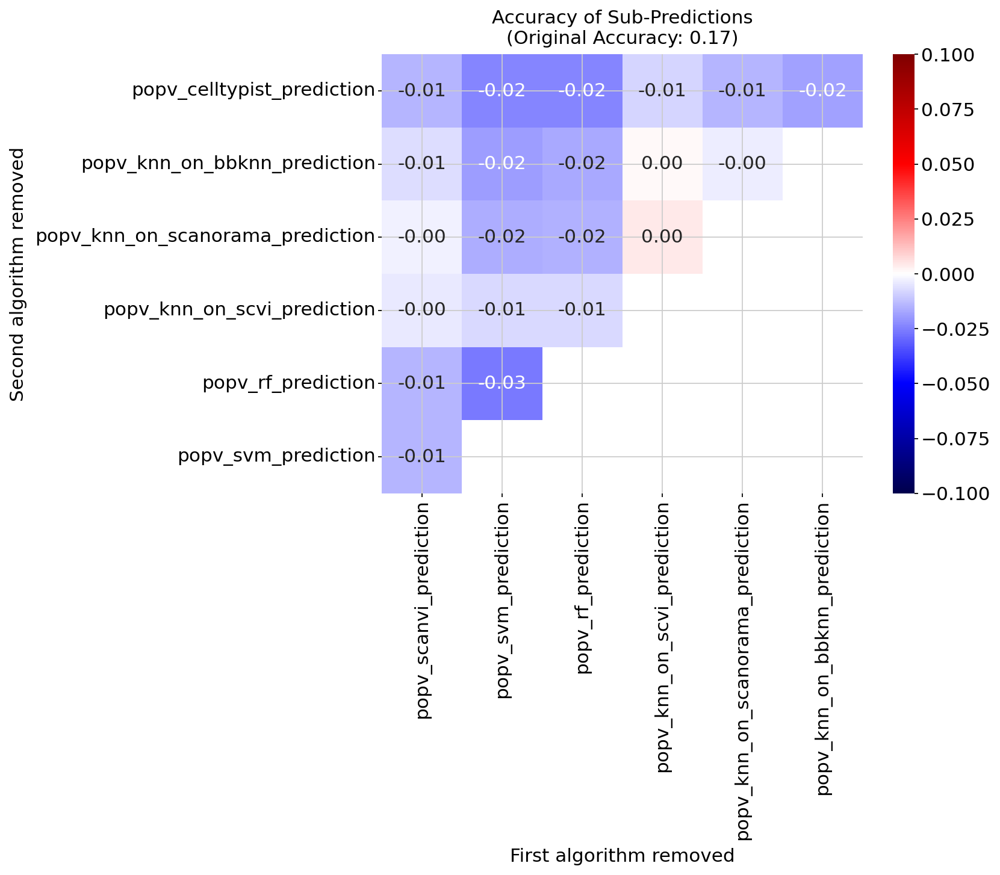

In [87]:
accuracy_df = accuracy_df.iloc[accuracy_df.isnull().sum(axis=1).mul(-1).argsort()[::-1], accuracy_df.isnull().sum(axis=0).mul(-1).argsort()[::-1]]
original_accuracy = f1_score(query_adata.obs['cell_ontology_class'], query_adata.obs['popv_prediction'], average='weighted')
loss_accuracy_df = accuracy_df - original_accuracy
plt.figure(figsize=(8, 6))
sns.heatmap(loss_accuracy_df, annot=True, cmap="seismic", fmt=".2f", vmin=-0.1, vmax=0.1)
plt.title(f'Accuracy of Sub-Predictions\n(Original Accuracy: {original_accuracy:.2f})')
plt.xlabel('First algorithm removed')
plt.ylabel('Second algorithm removed')
plt.savefig(f'{output_folder}/sub_prediction_accuracy_thymus.pdf', bbox_inches='tight')
plt.show()

maxp pruned
cmap pruned
kern dropped
post pruned
FFTM dropped
GPOS pruned
GSUB pruned
glyf pruned
Added gid0 to subset
Added first four glyphs to subset
Closing glyph list over 'GSUB': 42 glyphs before
Glyph names: ['.notdef', '.null', 'F', 'O', 'P', 'S', 'a', 'b', 'c', 'd', 'e', 'equal', 'f', 'five', 'four', 'g', 'h', 'hyphen', 'i', 'k', 'l', 'm', 'minus', 'n', 'nonmarkingreturn', 'o', 'one', 'p', 'period', 'r', 's', 'seven', 'six', 'space', 't', 'three', 'two', 'u', 'underscore', 'v', 'y', 'zero']
Glyph IDs:   [0, 1, 2, 3, 16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 32, 41, 50, 51, 54, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 80, 81, 82, 83, 85, 86, 87, 88, 89, 92, 3228]
Closed glyph list over 'GSUB': 47 glyphs after
Glyph names: ['.notdef', '.null', 'F', 'O', 'P', 'S', 'a', 'b', 'c', 'd', 'e', 'equal', 'f', 'fi', 'five', 'fl', 'four', 'g', 'h', 'hyphen', 'i', 'k', 'l', 'm', 'minus', 'n', 'nonmarkingreturn', 'o', 'one', 'p', 'period', 'r', 's', 'seven', 'six', 'space', 't', 'three

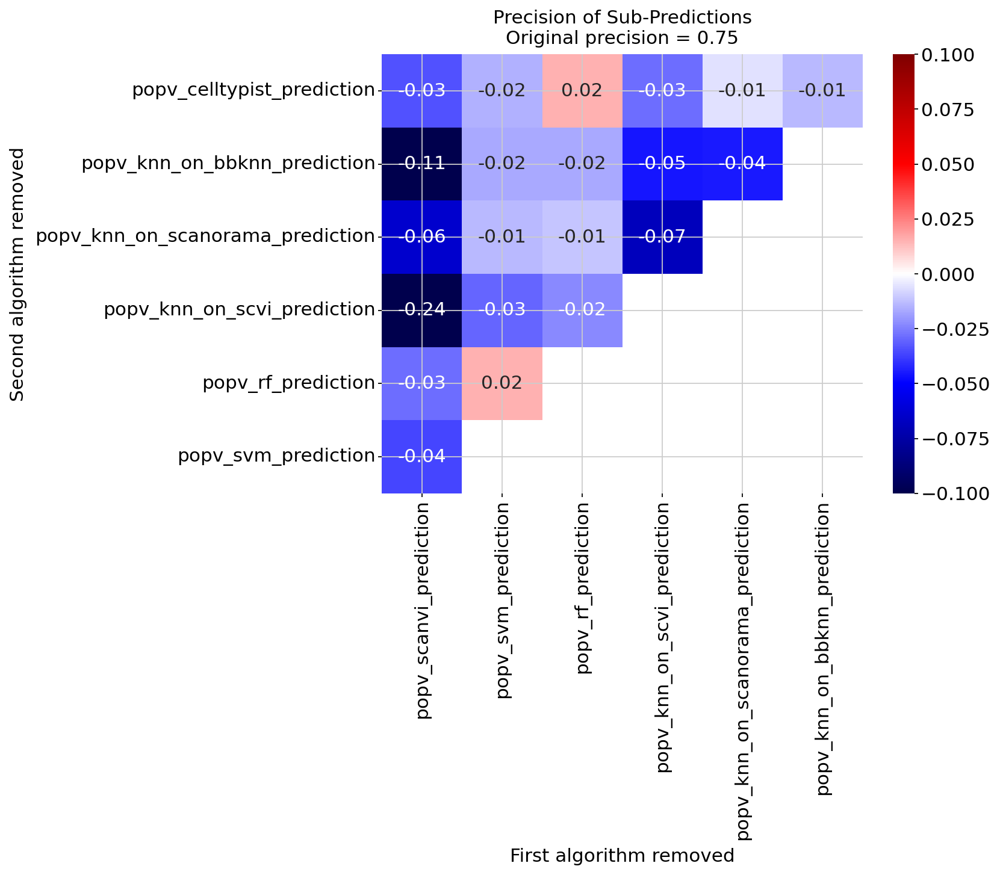

In [88]:
precision_df = precision_df.iloc[precision_df.isnull().sum(axis=1).mul(-1).argsort()[::-1], precision_df.isnull().sum(axis=0).mul(-1).argsort()[::-1]]
original_precision = average_precision_score(query_adata.obs['cell_ontology_class'].astype(str)==query_adata.obs['popv_prediction'], query_adata.obs['popv_prediction_score'], average='weighted')
loss_precision_df = precision_df - original_precision

plt.figure(figsize=(8, 6))
sns.heatmap(loss_precision_df, annot=True, cmap="seismic", fmt=".2f", vmin=-0.1, vmax=0.1)
plt.title(f'Precision of Sub-Predictions\nOriginal precision = {original_precision:.2f}')
plt.xlabel('First algorithm removed')
plt.ylabel('Second algorithm removed')
plt.savefig(f'{output_folder}/sub_prediction_precision_thymus.pdf', bbox_inches='tight')
plt.show()

In [46]:
prediction_keys = ['popv_knn_on_scanorama_prediction', 'popv_knn_on_scvi_prediction', 'popv_rf_prediction', 'popv_svm_prediction', 'popv_scanvi_prediction',
                   'popv_celltypist_prediction', 'popv_knn_on_bbknn_prediction'] # onclass
sub_prediction_list = list(itertools.combinations(prediction_keys, 5))

In [47]:
adult = query[query.obs['development_stage']=='human early adulthood stage']

In [58]:
accuracy_results = {}

for sub_prediction_key in sub_prediction_list:
    # Generate sub-predictions by applying majority_vote to each combination
    sub_prediction = query.obs[list(sub_prediction_key)].apply(_utils.majority_vote, axis=1)
    
    # Calculate accuracy
    # Binarize sub_predictions
    accuracy = f1_score(query.obs['cell_ontology_class'], sub_prediction, average='weighted')
    
    # Store the accuracy
    accuracy_results[tuple(set(prediction_keys) - set(sub_prediction_key))] = accuracy

# Convert accuracy results to a format suitable for heatmap plotting
accuracy_df = pd.DataFrame(list(accuracy_results.items()), columns=['Combination', 'Accuracy'])
accuracy_df[['Key1', 'Key2']] = pd.DataFrame(accuracy_df['Combination'].tolist(), index=accuracy_df.index)
accuracy_df = accuracy_df.pivot("Key1", "Key2", "Accuracy")

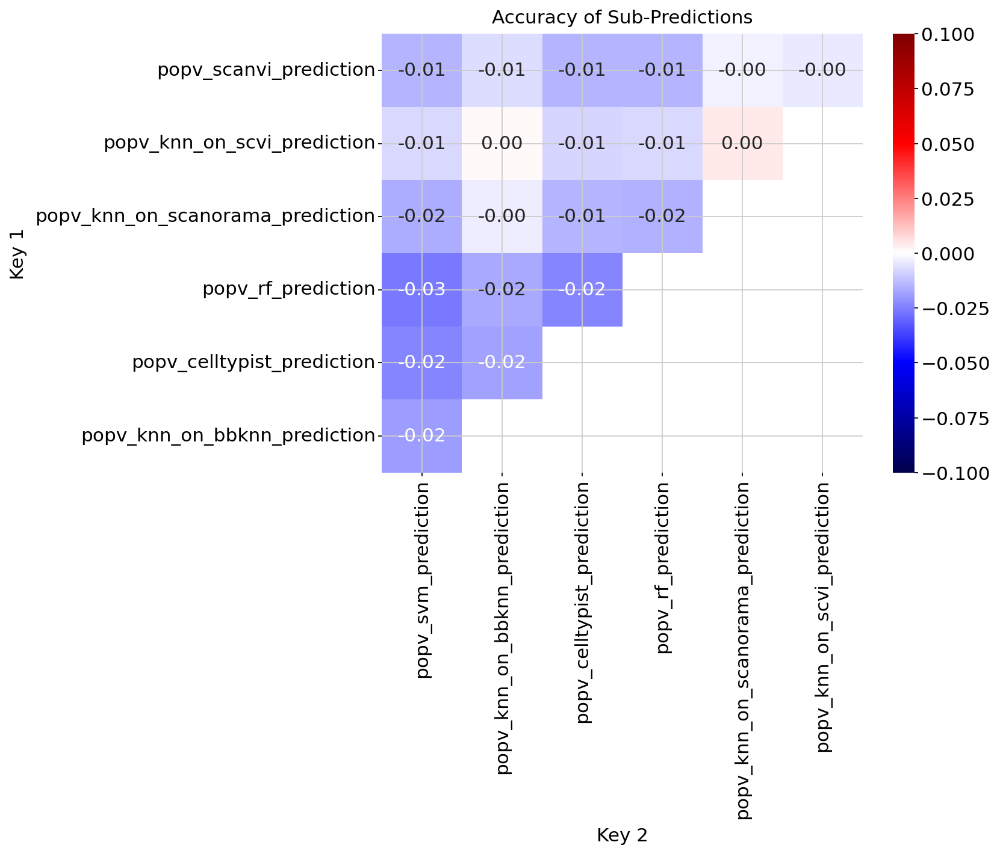

In [60]:
accuracy_df = accuracy_df.iloc[accuracy_df.isnull().sum(axis=1).mul(-1).argsort()[::-1], accuracy_df.isnull().sum(axis=0).mul(-1).argsort()[::-1]]
loss_accuracy_df = accuracy_df - f1_score(query.obs['cell_ontology_class'], query.obs['popv_prediction'], average='weighted')

plt.figure(figsize=(8, 6))
sns.heatmap(loss_accuracy_df, annot=True, cmap="seismic", fmt=".2f", vmin=-0.1, vmax=0.1)
plt.title('Accuracy of Sub-Predictions')
plt.xlabel('Key 2')
plt.ylabel('Key 1')
plt.show()

In [63]:
query

AnnData object with n_obs × n_vars = 255901 × 4000
    obs: 'tissue_in_publication', 'donor_id', 'free_annotation', 'compartment', 'cell_type_ontology_term_id', 'cell_type', 'assay', 'sex', 'tissue', 'cell_ontology_class', 'cell_ontology_class_tissue', 'donor_tissue', 'assay_correct', 'donor_assay', 'cell_ontology_class_original', '_batch_annotation', '_labels_annotation', '_ref_subsample', 'Sample', 'paper_annotation', 'development_stage', '_dataset', 'n_counts', 'popv_celltypist_prediction', 'popv_celltypist_prediction_probabilities', 'popv_knn_on_bbknn_prediction', 'popv_knn_on_bbknn_prediction_probabilities', 'popv_knn_on_scanorama_prediction', 'popv_knn_on_scanorama_prediction_probabilities', 'subsampled_labels', '_scvi_batch', '_scvi_labels', 'popv_knn_on_scvi_prediction', 'popv_knn_on_scvi_prediction_probabilities', '_labels_annotation_cell_ontology_id', 'popv_onclass_prediction', 'popv_onclass_seen', 'popv_onclass_prediction_probabilities', 'popv_onclass_seen_probabilities', 'p

In [64]:
accuracy_results = {}

for sub_prediction_key in sub_prediction_list:
    # Generate sub-predictions by applying majority_vote to each combination
    sub_prediction = query.obs[list(sub_prediction_key)].apply(_utils.majority_vote, axis=1)
    sub_prediction_score = query.obs[list(sub_prediction_key)].apply(_utils.majority_count, axis=1)
    
    # Calculate accuracy
    # Binarize sub_predictions
    accuracy = average_precision_score(query.obs['cell_ontology_class']==sub_prediction, sub_prediction_score, average='weighted')
    
    # Store the accuracy
    accuracy_results[tuple(set(prediction_keys) - set(sub_prediction_key))] = accuracy

# Convert accuracy results to a format suitable for heatmap plotting
accuracy_df = pd.DataFrame(list(accuracy_results.items()), columns=['Combination', 'Accuracy'])
accuracy_df[['Key1', 'Key2']] = pd.DataFrame(accuracy_df['Combination'].tolist(), index=accuracy_df.index)
accuracy_df = accuracy_df.pivot("Key1", "Key2", "Accuracy")

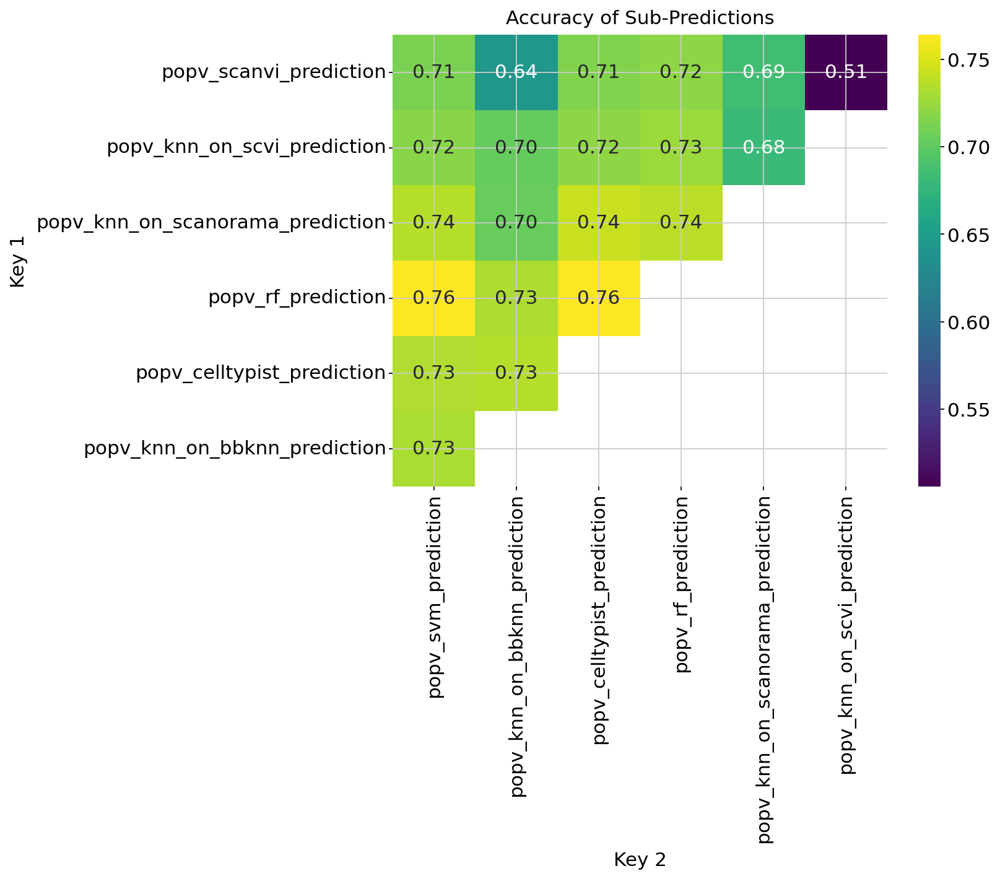

In [74]:
accuracy_df = accuracy_df.iloc[accuracy_df.isnull().sum(axis=1).mul(-1).argsort()[::-1], accuracy_df.isnull().sum(axis=0).mul(-1).argsort()[::-1]]
loss_accuracy_df = accuracy_df #- average_precision_score(query.obs['cell_ontology_class'].astype(str)==query.obs['popv_prediction'], query.obs['popv_prediction_score'], average='weighted')

plt.figure(figsize=(8, 6))
sns.heatmap(loss_accuracy_df, annot=True, cmap="viridis", fmt=".2f")
plt.title('Accuracy of Sub-Predictions')
plt.xlabel('Key 2')
plt.ylabel('Key 1')
plt.show()

In [76]:
accuracy_results = {}

for sub_prediction_key in sub_prediction_list:
    # Generate sub-predictions by applying majority_vote to each combination
    sub_prediction = query.obs[list(sub_prediction_key)].apply(_utils.majority_vote, axis=1)
    sub_prediction_score = query.obs[list(sub_prediction_key)].apply(_utils.majority_count, axis=1)
    
    # Calculate accuracy
    # Binarize sub_predictions
    accuracy = average_precision_score(query.obs['cell_ontology_class'].astype(str)==query.obs['popv_prediction'], sub_prediction_score, average='weighted')
    
    # Store the accuracy
    accuracy_results[tuple(set(prediction_keys) - set(sub_prediction_key))] = accuracy

# Convert accuracy results to a format suitable for heatmap plotting
accuracy_df = pd.DataFrame(list(accuracy_results.items()), columns=['Combination', 'Accuracy'])
accuracy_df[['Key1', 'Key2']] = pd.DataFrame(accuracy_df['Combination'].tolist(), index=accuracy_df.index)
accuracy_df = accuracy_df.pivot("Key1", "Key2", "Accuracy")

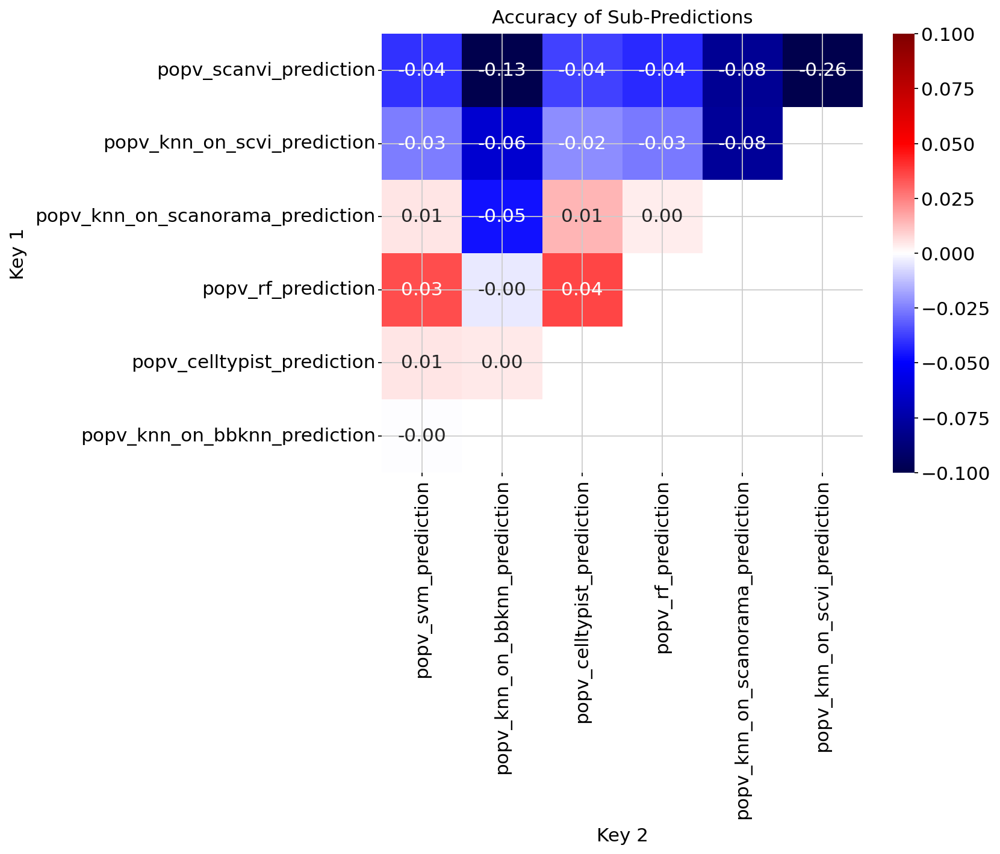

In [77]:
accuracy_df = accuracy_df.iloc[accuracy_df.isnull().sum(axis=1).mul(-1).argsort()[::-1], accuracy_df.isnull().sum(axis=0).mul(-1).argsort()[::-1]]
loss_accuracy_df = accuracy_df - average_precision_score(query.obs['cell_ontology_class'].astype(str)==query.obs['popv_prediction'], query.obs['popv_prediction_score'], average='weighted')

plt.figure(figsize=(8, 6))
sns.heatmap(loss_accuracy_df, annot=True, cmap="seismic", fmt=".2f", vmin=-0.1, vmax=0.1)
plt.title('Accuracy of Sub-Predictions')
plt.xlabel('Key 2')
plt.ylabel('Key 1')
plt.show()

In [ ]:
consensus_prediction = query.obs[prediction_keys].apply(
    _utils.majority_vote, axis=1
)
query.obs["popv_wo_onclass"] = consensus_prediction

agreement = query.obs[prediction_keys].apply(_utils.majority_count, axis=1)
query.obs["popv_wo_onclass_probabilities"] = agreement.values/len(prediction_keys)
for i in range(len(prediction_keys)):
    # Create a new row with all elements except the one at the current index
    for j in range(i+1, len(prediction_keys)):
        sub_prediction_key = [prediction_keys[i], prediction_keys[j]]
        
    sub_prediction = query.obs[sub_prediction_key].apply(
        _utils.majority_vote, axis=1
    )
    query.obs[f"wo_onclass_scanvi_{prediction_keys[i]}"] = sub_prediction
    sub_agreement = query.obs[sub_prediction_key].apply(_utils.majority_count, axis=1)
    query.obs[f"wo_onclass_scanvi_{prediction_keys[i]}_score"] = sub_agreement.values/len(sub_prediction_key)

In [28]:
obo_fn = '../../PopV/ontology/cl.obo'
G = popv._utils.make_ontology_dag(obo_fn)

In [29]:
query.obs['popv_parent']

4861STDY7462263-GGTGAAGCACGGCTAC    CD4-positive, alpha-beta T cell
4861STDY7462261-CCTAGCTGTCCAACTA                          thymocyte
4861STDY7462261-CCTAGCTGTAGCTGCC                             T cell
4861STDY7462261-CCTAGCTCATGTAGTC                             T cell
4861STDY7462261-CCTAGCTCAGCTGTGC                             B cell
                                                 ...               
T07_TH_TOT_1_S1-CAGCTGGAGTTCGCAT                             T cell
T07_TH_TOT_1_S1-CAGCTGGAGCGATGAC                             T cell
T07_TH_TOT_1_S1-CAGCTGGAGAGGGCTT                   mononuclear cell
T07_TH_TOT_1_S1-CAGCTAATCTGCAAGT                             T cell
T07_TH_TOT_1_S1-CAGCTGGTCATAAAGG    CD4-positive, alpha-beta T cell
Name: popv_parent, Length: 255901, dtype: category
Categories (40, object): ['B cell', 'CD4-positive helper T cell', 'CD4-positive, CD25-positive, alpha-beta regul..., 'CD4-positive, alpha-beta T cell', ..., 'pro-T cell', 'professional antigen presenti

In [39]:
import networkx as nx

query.obs['parent_in_path'] = query.obs[['popv_parent', 'cell_ontology_class']].apply(lambda x: x['popv_parent'] in nx.shortest_path_length(G, x['cell_ontology_class']), axis=1).astype(str)

In [40]:
data = query.obs[['consensus_ontology_accuracy', 'parent_in_path']].value_counts().reset_index()

In [45]:
sc.settings.set_figure_params(dpi=300, vector_friendly=True)
sc.settings.figdir = 'fig4'

maxp pruned
cmap pruned
kern dropped
post pruned
FFTM dropped
GPOS pruned
GSUB pruned
glyf pruned
Added gid0 to subset
Added first four glyphs to subset
Closing glyph list over 'GSUB': 45 glyphs before
Glyph names: ['.notdef', '.null', 'A', 'B', 'C', 'D', 'F', 'K', 'M', 'N', 'P', 'T', 'U', 'a', 'b', 'c', 'comma', 'd', 'e', 'eight', 'f', 'five', 'four', 'g', 'h', 'hyphen', 'i', 'k', 'l', 'm', 'n', 'nonmarkingreturn', 'o', 'one', 'p', 'r', 's', 'space', 't', 'two', 'u', 'underscore', 'v', 'x', 'y']
Glyph IDs:   [0, 1, 2, 3, 15, 16, 20, 21, 23, 24, 27, 36, 37, 38, 39, 41, 46, 48, 49, 51, 55, 56, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 80, 81, 82, 83, 85, 86, 87, 88, 89, 91, 92]
Closed glyph list over 'GSUB': 50 glyphs after
Glyph names: ['.notdef', '.null', 'A', 'B', 'C', 'D', 'F', 'K', 'M', 'N', 'P', 'T', 'U', 'a', 'b', 'c', 'comma', 'd', 'e', 'eight', 'f', 'fi', 'five', 'fl', 'four', 'g', 'h', 'hyphen', 'i', 'k', 'l', 'm', 'n', 'nonmarkingreturn', 'o', 'one', 'p', 'r', 's', 'spa

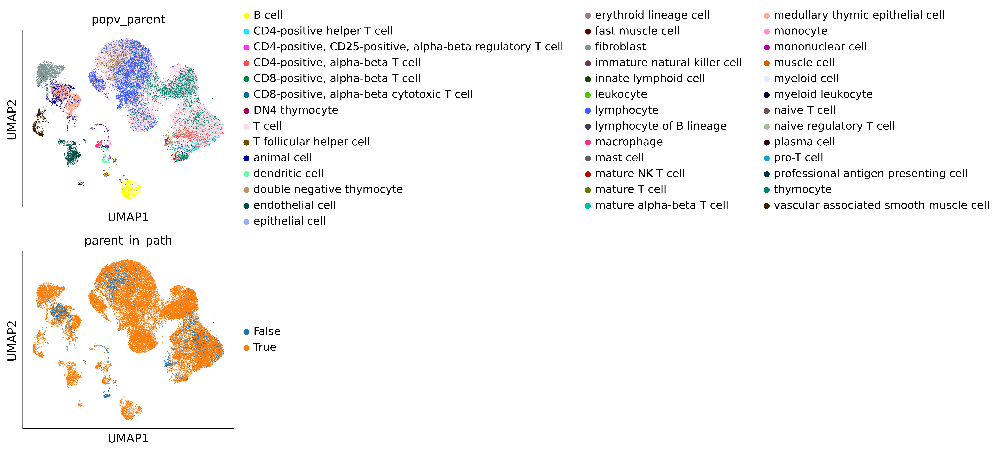

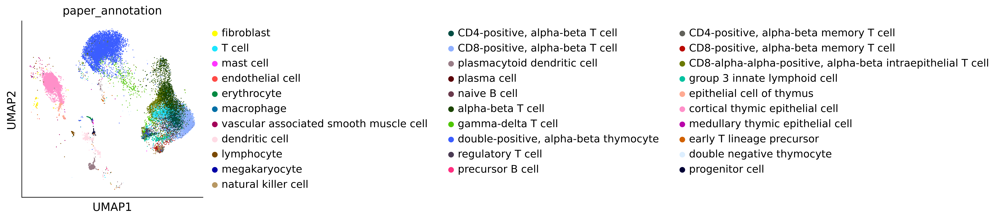

In [46]:
sc.pl.umap(query, color=['popv_parent', 'parent_in_path'], ncols=1, save='thymus_parent_in_path.pdf')
sc.pl.umap(query[query.obs['parent_in_path']=='False'], color='paper_annotation')

maxp pruned
cmap pruned
kern dropped
post pruned
FFTM dropped
GPOS pruned
GSUB pruned
glyf pruned
Added gid0 to subset
Added first four glyphs to subset
Closing glyph list over 'GSUB': 45 glyphs before
Glyph names: ['.notdef', '.null', 'A', 'B', 'C', 'N', 'O', 'P', 'S', 'a', 'b', 'c', 'd', 'e', 'eight', 'five', 'four', 'g', 'h', 'i', 'k', 'l', 'm', 'n', 'nine', 'nonmarkingreturn', 'o', 'one', 'p', 'parenleft', 'parenright', 'period', 'r', 's', 'six', 'space', 't', 'three', 'two', 'u', 'w', 'x', 'y', 'z', 'zero']
Glyph IDs:   [0, 1, 2, 3, 11, 12, 17, 19, 20, 21, 22, 23, 24, 25, 27, 28, 36, 37, 38, 49, 50, 51, 54, 68, 69, 70, 71, 72, 74, 75, 76, 78, 79, 80, 81, 82, 83, 85, 86, 87, 88, 90, 91, 92, 93]
Closed glyph list over 'GSUB': 45 glyphs after
Glyph names: ['.notdef', '.null', 'A', 'B', 'C', 'N', 'O', 'P', 'S', 'a', 'b', 'c', 'd', 'e', 'eight', 'five', 'four', 'g', 'h', 'i', 'k', 'l', 'm', 'n', 'nine', 'nonmarkingreturn', 'o', 'one', 'p', 'parenleft', 'parenright', 'period', 'r', 's',

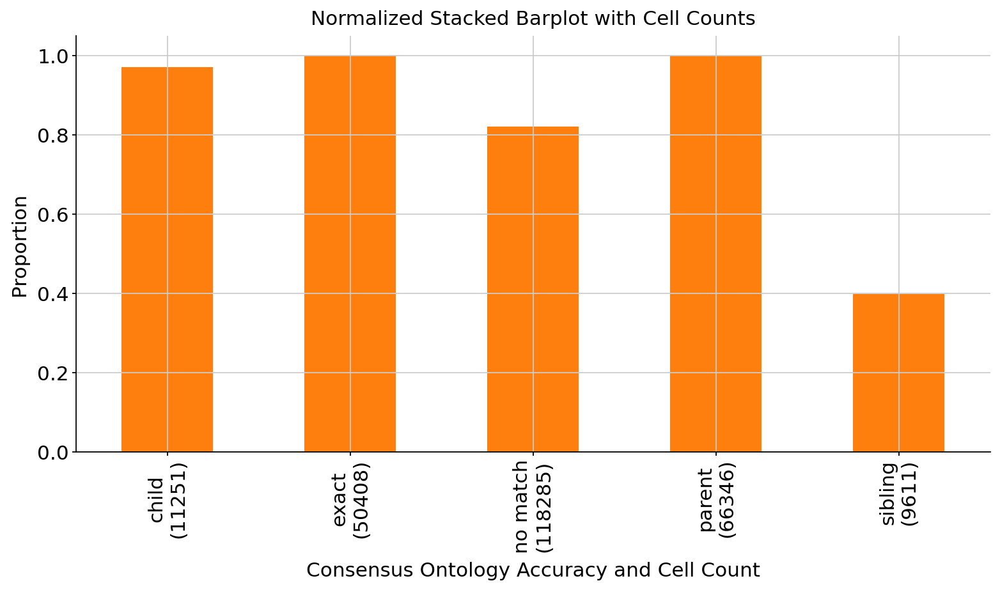

In [35]:
import pandas as pd
import matplotlib.pyplot as plt

# Convert to DataFrame
df = pd.DataFrame(data)
df.columns = ['consensus_ontology_accuracy', 'parent_in_path', 'count']

# Calculate total count for normalization
df['total'] = df.groupby('consensus_ontology_accuracy')['count'].transform('sum')

# Normalize count
df['normalized_count'] = df['count'] / df['total']

# Pivot the DataFrame for plotting
pivot_df = df.pivot(index='consensus_ontology_accuracy', columns='parent_in_path', values='normalized_count').fillna(0)[True]

# Plot
ax = pivot_df.plot(kind='bar', stacked=True, color='#ff7f0e', figsize=(10, 6))

# Add total count to x-axis labels
total_counts = df.groupby('consensus_ontology_accuracy')['total'].first()
new_labels = [f"{idx}\n({total_counts[idx]})" for idx in pivot_df.index]
ax.set_xticklabels(new_labels)

plt.title('Normalized Stacked Barplot with Cell Counts')
plt.xlabel('Consensus Ontology Accuracy and Cell Count')
plt.ylabel('Proportion')
plt.xticks(rotation=90)
plt.tight_layout()
plt.savefig('fig4/fig4_thymus_parent_in_path.pdf', bbox_inches='tight')
plt.show()

In [36]:
counts = query.obs.loc[
    query.obs['consensus_ontology_accuracy'].isin(['no match', 'sibling']),
    ['paper_annotation', 'popv_parent', 'consensus_ontology_accuracy', 'parent_in_path']
].value_counts().sort_index(level=0, sort_remaining=False)
print(counts[counts['Cell']>500].to_latex())

KeyError: 'Cell'

In [487]:
counts = counts.reset_index(name='Cell').set_index('paper_annotation')
print(counts[counts['Cell']>500].to_latex())

\begin{tabular}{llllr}
\toprule
{} &                       popv\_parent & consensus\_ontology\_accuracy &  parent\_in\_path &   Cell \\
paper\_annotation                                   &                                   &                             &                 &        \\
\midrule
T cell                                             &                            T cell &                    no match &            True &   2545 \\
T cell                                             &                         thymocyte &                    no match &           False &    773 \\
CD4-positive, alpha-beta T cell                    &                            T cell &                    no match &            True &   4270 \\
CD4-positive, alpha-beta T cell                    &                         thymocyte &                    no match &           False &   1821 \\
CD8-positive, alpha-beta T cell                    &                            T cell &                    no match & 

/tmp/ipykernel_1972633/3568596310.py:2: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  print(counts[counts['Cell']>500].to_latex())


In [187]:
df = query.obs[["popv_prediction_score", 'consensus_ontology_accuracy']]
scores = np.unique(df['popv_prediction_score'])
acc_labels = np.unique(df['consensus_ontology_accuracy'])
parent = 'parent'
child = 'child'
exact = 'exact'
sibling = 'sibling'

In [188]:
exact_acc = []
parent_acc = []
child_acc = []
sibling_acc = []
neighborhood_acc = []
ns = []
for score in scores:
    tmp = df[df['popv_prediction_score']==score]
    n = tmp.shape[0]
    
    ns.append(n)
    
    correct1 = tmp[tmp['consensus_ontology_accuracy'] == exact].shape[0]
    exact_acc.append(correct1)
    
    correct2 = tmp[tmp['consensus_ontology_accuracy'] == parent].shape[0]
    parent_acc.append(correct2)
    
    correct3 = tmp[tmp['consensus_ontology_accuracy'] == child].shape[0]
    child_acc.append(correct3)
    
    correct4 = tmp[tmp['consensus_ontology_accuracy'] == sibling].shape[0]
    sibling_acc.append(correct4)
    
    neighborhood_score = (correct1+correct2+correct3+correct4)/n
    neighborhood_acc.append(neighborhood_score)

In [189]:
labels = [f'{s} (n={n})' for s,n in zip(scores, ns)]

In [190]:
df = pd.DataFrame(index = labels)

In [191]:
df['Exact Match'] = exact_acc
df['Parent Match'] = parent_acc
df['Child Match'] = child_acc
df['Sibling Match'] = sibling_acc
df['No Match'] =  np.array(ns) - df.sum(axis=1)

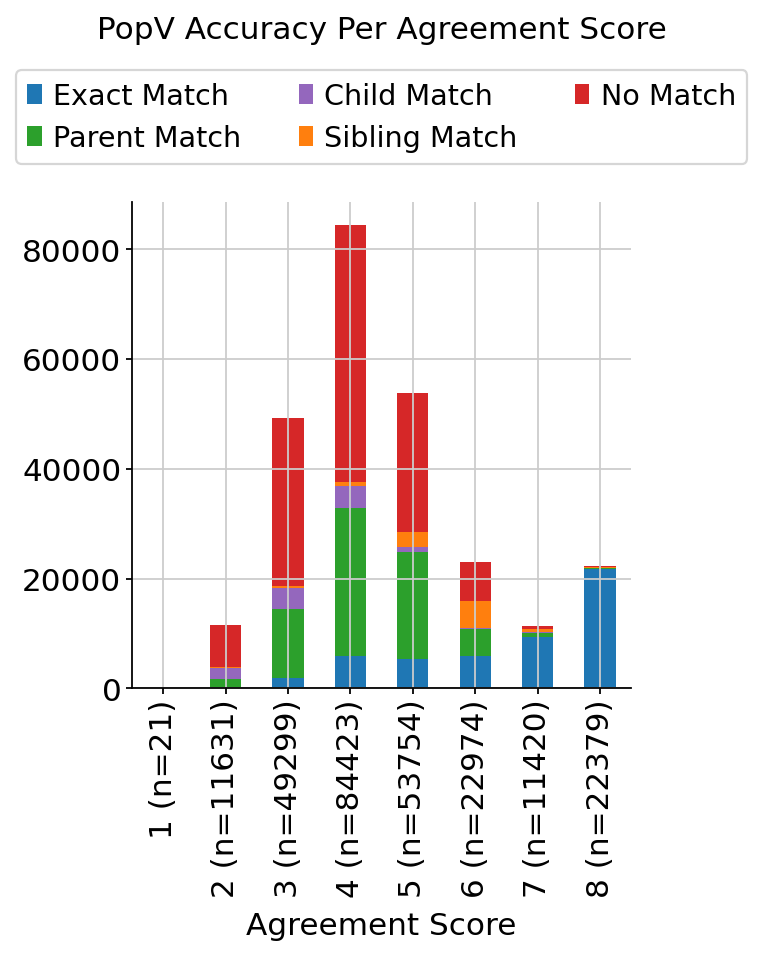

In [192]:
ax = df.plot.bar(stacked=True, color=color_map)

ax.set_xlabel('Agreement Score')
ax.set_title('PopV Accuracy Per Agreement Score', y=1.3)

ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=3)
plt.savefig('fig4/fig4_thymus_prediction_accuracy_new.pdf', bbox_inches='tight')

# UMAP probabilities predictors

In [5]:
from scanpy.plotting import palettes

In [6]:
cell_types = pd.unique(query.obs[[i for i in query.uns['prediction_keys']]].values.ravel('K'))
palette = palettes.default_102
sub_cluster_id_colors = {i: j for i, j in zip(list(cell_types), palette)}

In [7]:
color_keys = [[i+'_probabilities', i] for i in query.uns['prediction_keys']]
color_keys =  sum(color_keys, [])

In [8]:
adult = query[query.obs['development_stage']=='human early adulthood stage']
fetal = query[['th week' in i for i in query.obs['development_stage']]]

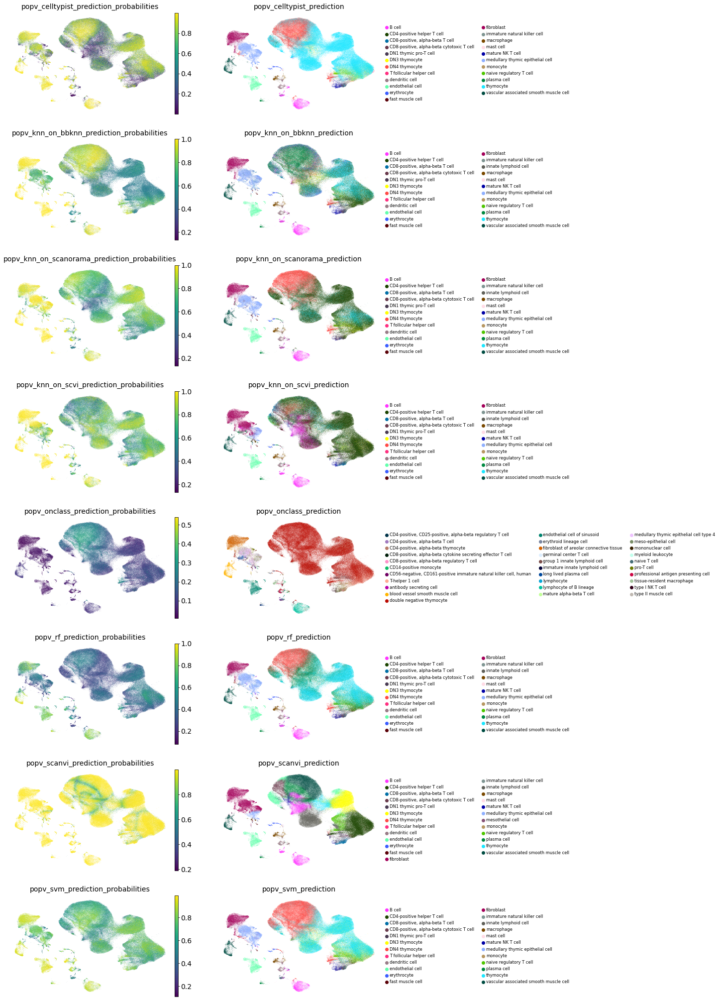

In [12]:
sc.pl.umap(query, color=color_keys, ncols=2, palette=sub_cluster_id_colors, frameon=False, legend_fontsize='small',
           show=True, save='predictors_thymus.pdf')

/home/cane/miniconda3/lib/python3.8/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


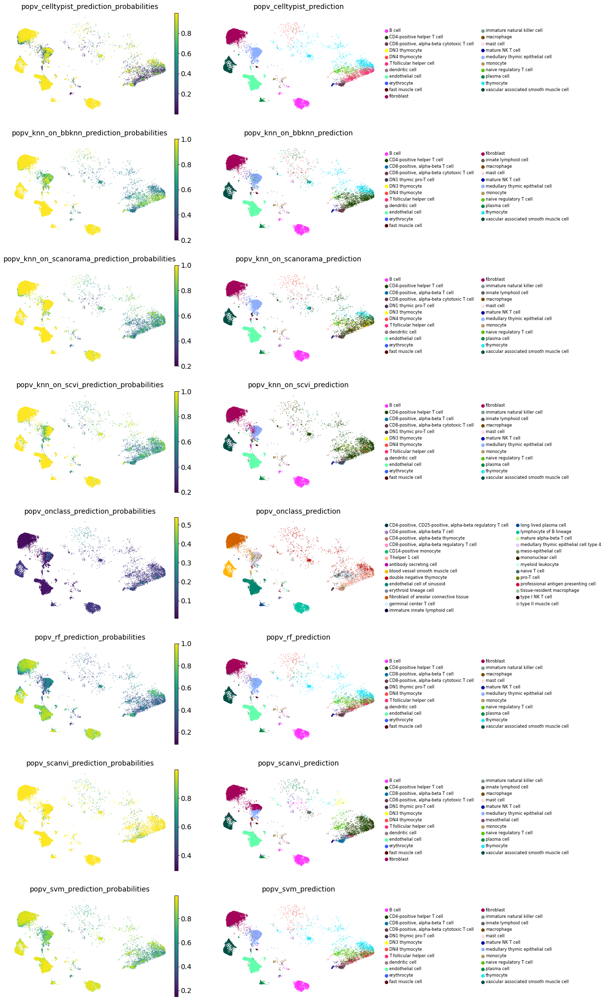

In [10]:
sc.pl.umap(adult, color=color_keys, ncols=2, palette=sub_cluster_id_colors, frameon=False, legend_fontsize='small',
           show=True, save='predictors_thymus_adult.pdf')

/home/cane/miniconda3/lib/python3.8/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


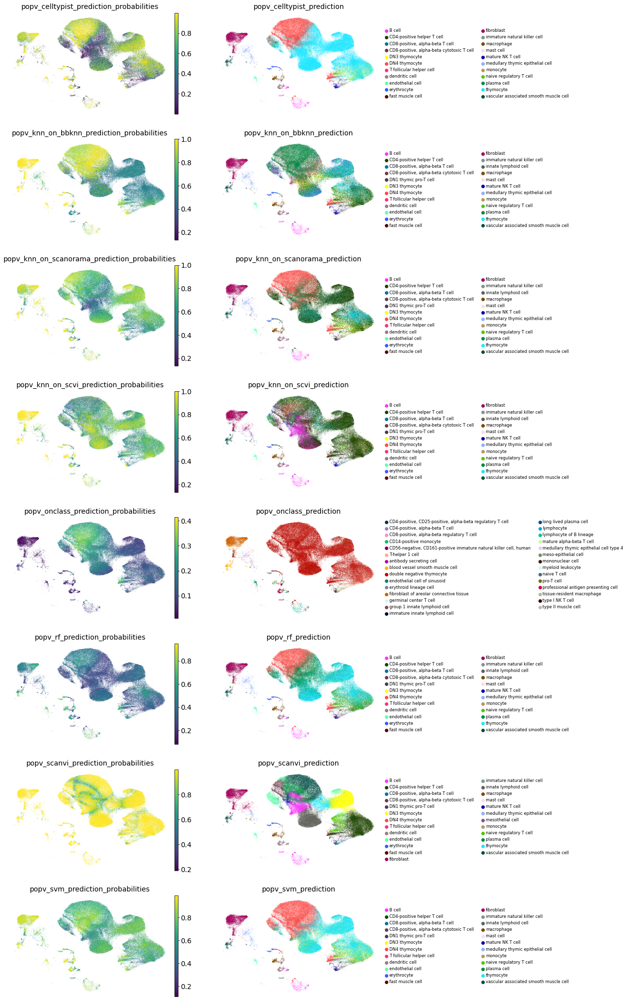

In [11]:
sc.pl.umap(fetal, color=color_keys, ncols=2, palette=sub_cluster_id_colors, frameon=False, legend_fontsize='small',
           show=True, save='predictors_thymus_fetal.pdf')

# Outlier endothelial cells

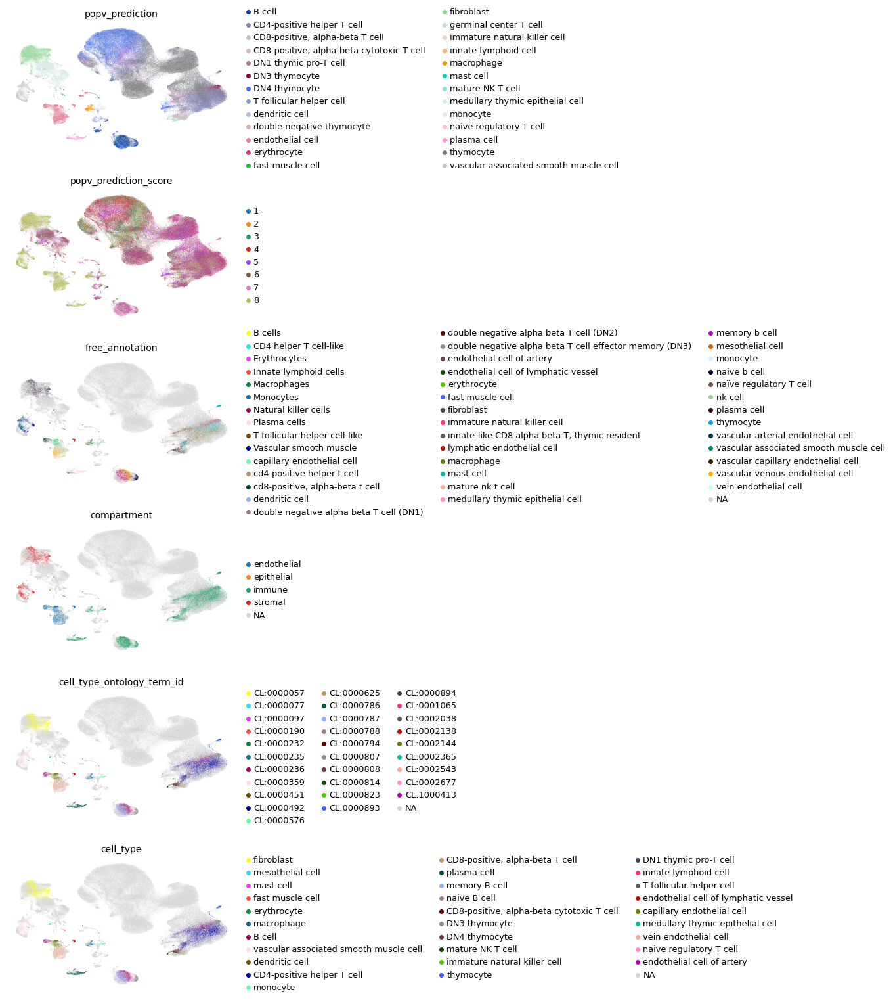

In [11]:
full_fn.obsm['X_umap'] = full_fn.obsm['X_scanvi_umap_popv']
sc.pl.umap(full_fn, color=['popv_prediction', 'popv_prediction_score', 'free_annotation', 'compartment', 'cell_type_ontology_term_id', 'cell_type'], show=True, ncols=1)

In [16]:
full_fn.X.data

array([3.236711  , 3.910016  , 3.236711  , ..., 0.63162774, 4.1583805 ,
       0.        ], dtype=float32)

/home/cane/miniconda3/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/cane/miniconda3/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/cane/miniconda3/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: DataFrame is highly fragmente

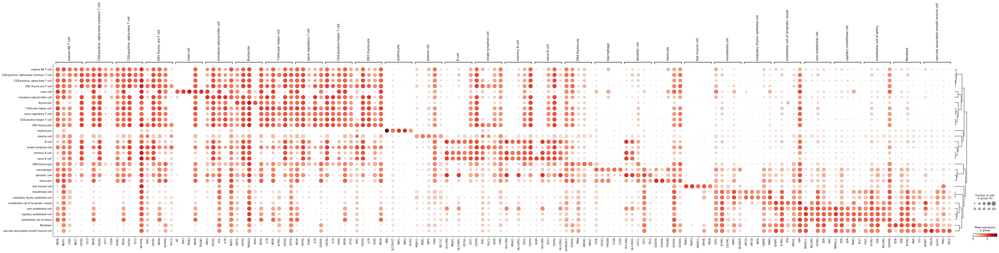

In [19]:
full_fn.uns['log1p']['base'] = 2
sc.tl.rank_genes_groups(full_fn, groupby='cell_type')
sc.pl.rank_genes_groups_dotplot(full_fn, n_genes=5)